# YOLOv5 for TACO
## train & detect TACO-2

## Repro [Github](https://github.com/ultralytics/yolov5)

In [1]:
!git clone https://github.com/rkuo2000/yolov5
%cd yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 2578, done.
remote: Total 2578 (delta 0), reused 0 (delta 0), pack-reused 2578
Receiving objects: 100% (2578/2578), 5.40 MiB | 24.46 MiB/s, done.
Resolving deltas: 100% (1702/1702), done.
/kaggle/working/yolov5


In [7]:
!pip install pycocotools

  Using cached pycocotools-2.0.3.tar.gz (106 kB)
  Running setup.py clean for pycocotools
Failed to build pycocotools
    Running setup.py install for pycocotools: started
    Running setup.py install for pycocotools: finished with status 'error'


  ERROR: Command errored out with exit status 1:
   command: 'C:\Users\kharr\miniconda3\python.exe' -u -c 'import io, os, sys, setuptools, tokenize; sys.argv[0] = '"'"'C:\\Users\\kharr\\AppData\\Local\\Temp\\pip-install-j0p_w94h\\pycocotools_317bde80ee94437b80d5c5137abd972b\\setup.py'"'"'; __file__='"'"'C:\\Users\\kharr\\AppData\\Local\\Temp\\pip-install-j0p_w94h\\pycocotools_317bde80ee94437b80d5c5137abd972b\\setup.py'"'"';f = getattr(tokenize, '"'"'open'"'"', open)(__file__) if os.path.exists(__file__) else io.StringIO('"'"'from setuptools import setup; setup()'"'"');code = f.read().replace('"'"'\r\n'"'"', '"'"'\n'"'"');f.close();exec(compile(code, __file__, '"'"'exec'"'"'))' bdist_wheel -d 'C:\Users\kharr\AppData\Local\Temp\pip-wheel-05x97kf1'
       cwd: C:\Users\kharr\AppData\Local\Temp\pip-install-j0p_w94h\pycocotools_317bde80ee94437b80d5c5137abd972b\
  Complete output (14 lines):
  running bdist_wheel
  running build
  running build_py
  creating build
  creating build\lib.win-am

In [2]:
from utils.downloads import *
attempt_download('weights/yolov5s.pt')
#attempt_download('weights/yolov5m.pt')
#attempt_download('weights/yolov5l.pt')
#attempt_download('weights/yolov5x.pt')

100%|██████████| 14.0M/14.0M [00:01<00:00, 12.0MB/s]

'weights\\yolov5s.pt'

## Prepare Dataset

In [1]:
import os
import shutil
import numpy as np
import tqdm
import pycocotools

### read annotations.json

In [22]:
from pycocotools.coco import COCO
data_source = COCO(annotation_file='../TACO/data/annotations.json')

loading annotations into memory...
Done (t=0.14s)
creating index...
index created!


>      'Clear plastic bottle': 5
>      'Plastic bottle cap': 7
>      'Drink can': 12
>      'Other plastic': 29
>      'Plastic film': 36
>      'Other plastic wrapper': 39
>      'Unlabeled litter': 58
>      'Cigarette': 59

In [3]:
# remapping label id to 0~1
label_transfer = {5: 0, 12: 1}

In [4]:
img_ids = data_source.getImgIds()

catIds = data_source.getCatIds()
categories = data_source.loadCats(catIds)
categories.sort(key=lambda x: x['id'])
classes = {}
coco_labels = {}
coco_labels_inverse = {}
for c in categories:
    coco_labels[len(classes)] = c['id']
    coco_labels_inverse[c['id']] = len(classes)
    classes[c['name']] = len(classes)

class_num = {}

### collect images & labels

In [9]:
!md tmp
!cd tmp
!md labels 
!md images
save_base_path  = 'tmp/labels/'
save_image_path = 'tmp/images/'

In [13]:
for index, img_id in tqdm.tqdm(enumerate(img_ids), desc='change .json file to .txt file'):
    img_info = data_source.loadImgs(img_id)[0]
    # 將含文件夾的路徑修改為文件名
    save_name = img_info['file_name'].replace('/', '_')
    # 移去文件擴展名
    file_name = save_name.split('.')[0]
    # 獲取單張圖像的寬和高
    height = img_info['height']
    width = img_info['width']
    # 轉換所得txt文件存儲路徑
    save_path = save_base_path + file_name + '.txt'
    is_exist = False  # 記錄圖片是否包含目標垃圾類型對象
    with open(save_path, mode='w') as fp:
        # 根據圖片編號找出垃圾對象的編號集合
        annotation_id = data_source.getAnnIds(img_id)
        boxes = np.zeros((0, 5))
        if len(annotation_id) == 0:  # 集合大小為0
            fp.write('')
            continue
        # 獲取coco格式的標籤
        annotations = data_source.loadAnns(annotation_id)
        lines = ''  # 記錄轉換後yolo格式的標籤
        # 遍歷對象標籤集
        for annotation in annotations:
            # 獲取垃圾對象的標籤
            label = coco_labels_inverse[annotation['category_id']]
            if label in label_transfer.keys():
                # 垃圾類型屬於目標垃圾類型則進行格式轉換
                is_exist = True
                box = annotation['bbox']
                if box[2] < 1 or box[3] < 1:
                    # 如果原標籤中出現無長或寬數據的情況則跳過
                    continue
                # top_x,top_y,width,height==>cen_x,cen_y,width,height
                box[0] = round((box[0] + box[2] / 2) / width, 6)
                box[1] = round((box[1] + box[3] / 2) / height, 6)
                box[2] = round(box[2] / width, 6)
                box[3] = round(box[3] / height, 6)
                label = label_transfer[label]  # 標籤映射
                if label not in class_num.keys():
                    class_num[label] = 0
                class_num[label] += 1
                lines = lines + str(label)  # 先存儲標籤
                for i in box:  # 再存儲位置信息
                    lines += ' ' + str(i)
                lines += '\n'  # 換行
        fp.writelines(lines)
    if is_exist:
        # 存在目標類型對象，則拷貝圖像至指定目錄
        shutil.copy('../TACO/data/{}'.format(img_info['file_name']), os.path.join(save_image_path, save_name))
    else:
        # 不存在則刪除所生成的標籤文件
        os.remove(save_path)

change .json file to .txt file: 1500it [00:07, 190.45it/s]


### Split Folder 
#### split into train, val, test (images & labels under each folder)

In [14]:
!pip install split-folders

### Display Test Images

In [15]:
import splitfolders
splitfolders.ratio('tmp', output="taco", seed=1337, ratio=(.8, 0.1,0.1)) 

Copying files: 708 files [00:11, 61.01 files/s]


## Train Model

>     $ python train.py --data coco.yaml --cfg yolov5s.yaml --weights '' --batch-size 64
                                             yolov5m                                40
                                             yolov5l                                24
                                             yolov5x                                16

In [23]:
 freeze = ['model.%s.' % x for x in range(10)]  # parameter names to freeze (full or partial)
!python train.py --img 320 --batch 1 --epochs 1 --data models/taco2.yaml --cfg models/yolov5s.yaml --weights yolov5s.pt --freeze 24
#!python train.py --img 320 --batch 1 --epochs 100 --data /kaggle/input/yolov5-taco-models/taco2.yaml --cfg models/yolov5s.yaml --weights /kaggle/input/yolov5-taco-models/taco2_epoch100_best.pt
#!python train.py --img 320 --batch 1 --epochs 100 --data /kaggle/input/yolov5-taco-models/taco2.yaml --cfg models/yolov5s.yaml --weights /kaggle/input/yolov5-taco-models/taco2_epoch200_best.pt
#!python train.py --img 320 --batch 1 --epochs 100 --data models/taco2.yaml --cfg models/yolov5s.yaml --weights weights/taco2_epoch300_best.pt

github: up to date with https://github.com/ultralytics/yolov5 
Weights & Biases: run 'pip install wandb' to automatically track and visualize YOLOv5  runs (RECOMMENDED)
module 'signal' has no attribute 'SIGALRM'
Optimizer stripped from runs\train\exp4\weights\last.pt, 14.3MB
Optimizer stripped from runs\train\exp4\weights\best.pt, 14.3MB


train: weights=yolov5s.pt, cfg=models/yolov5s.yaml, data=models/taco2.yaml, hyp=data\hyps\hyp.scratch.yaml, epochs=1, batch_size=1, imgsz=320, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs\train, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, patience=100, freeze=24, save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
YOLOv5  v6.0-144-gc9a46a6 torch 1.10.0+cpu CPU

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, degrees=0.0, translate=0.1, scale=0.5, shear=0.0, perspective=0.0, flipud=0.0, fliplr=0.5, mosaic=1.0, mixup=0.

## Detect Trash

In [13]:
## Model weights
#!cp /kaggle/input/yolov5-taco-models/taco2_epoch300_best.pt weights/best.pt
!cp runs/exp0/weights/best.pt weights

In [14]:
!ls taco/test/images

batch_10_000025.jpg   batch_3_IMG_4997.JPG  batch_6_000100.JPG
batch_12_000021.jpg   batch_3_IMG_5036.JPG  batch_7_000062.JPG
batch_13_000027.jpg   batch_3_IMG_5055.JPG  batch_7_000114.JPG
batch_13_000042.jpg   batch_3_IMG_5058.JPG  batch_8_000009.jpg
batch_14_000079.jpg   batch_4_000032.JPG    batch_8_000015.jpg
batch_15_000013.jpg   batch_5_000012.JPG    batch_8_000020.jpg
batch_1_000000.jpg    batch_5_000017.JPG    batch_8_000027.jpg
batch_1_000069.JPG    batch_5_000048.JPG    batch_8_000041.jpg
batch_2_000051.JPG    batch_5_000052.JPG    batch_8_000069.jpg
batch_2_000076.JPG    batch_6_000010.JPG    batch_8_000085.jpg
batch_2_000080.JPG    batch_6_000046.JPG    batch_9_000001.jpg
batch_3_IMG_4941.JPG  batch_6_000047.JPG    batch_9_000074.jpg


In [15]:
from IPython.display import Image

In [16]:
!python detect.py --weights weights/best.pt --img 320 --conf 0.4 --source taco/test/images/batch_1_000000.jpg

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=320, iou_thres=0.5, output='inference/output', save_txt=False, source='taco/test/images/batch_1_000000.jpg', update=False, view_img=False, weights=['weights/best.pt'])
Fusing layers... 
image 1/1 /kaggle/working/yolov5/taco/test/images/batch_1_000000.jpg: 320x256 1 Clear plastic bottles, 1 Drink cans, Done. (0.015s)
Results saved to inference/output
Done. (0.365s)


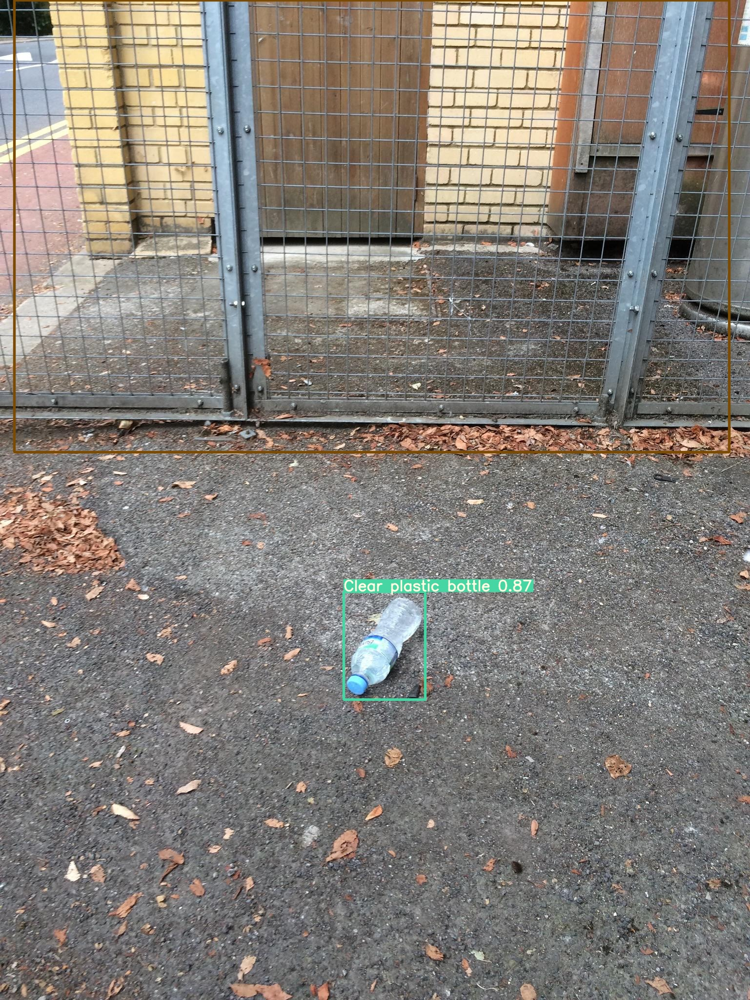

In [17]:
Image('inference/output/batch_1_000000.jpg')

In [18]:
!python detect.py --weights weights/best.pt --img 320 --conf 0.4 --source taco/test/images/batch_5_000017.JPG 

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=320, iou_thres=0.5, output='inference/output', save_txt=False, source='taco/test/images/batch_5_000017.JPG', update=False, view_img=False, weights=['weights/best.pt'])
Fusing layers... 
image 1/1 /kaggle/working/yolov5/taco/test/images/batch_5_000017.JPG: 320x256 1 Clear plastic bottles, Done. (0.016s)
Results saved to inference/output
Done. (0.507s)


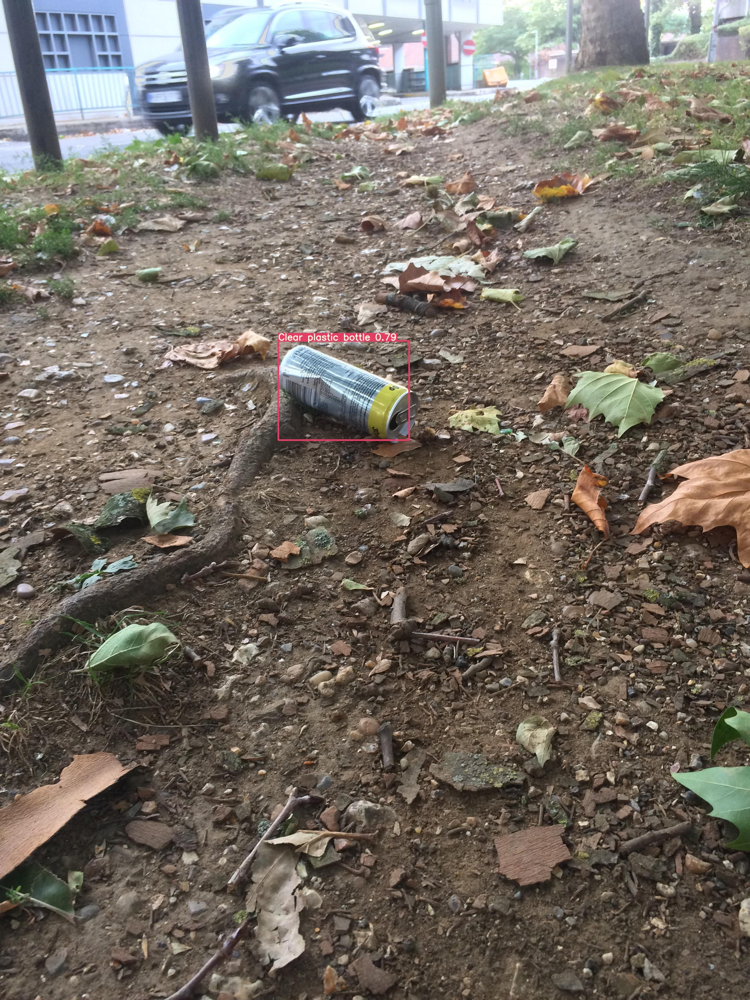

In [19]:
Image('inference/output/batch_5_000017.JPG')

## Detect test images folder

In [20]:
!python detect.py --weights weights/best.pt --img 320 --conf 0.4 --source taco/test/images 

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', img_size=320, iou_thres=0.5, output='inference/output', save_txt=False, source='taco/test/images', update=False, view_img=False, weights=['weights/best.pt'])
Fusing layers... 
image 1/36 /kaggle/working/yolov5/taco/test/images/batch_10_000025.jpg: 320x192 Done. (0.014s)
image 2/36 /kaggle/working/yolov5/taco/test/images/batch_12_000021.jpg: 320x192 1 Clear plastic bottles, Done. (0.013s)
image 3/36 /kaggle/working/yolov5/taco/test/images/batch_13_000027.jpg: 320x256 1 Clear plastic bottles, 1 Drink cans, Done. (0.017s)
image 4/36 /kaggle/working/yolov5/taco/test/images/batch_13_000042.jpg: 320x256 1 Clear plastic bottles, Done. (0.023s)
image 5/36 /kaggle/working/yolov5/taco/test/images/batch_14_000079.jpg: 320x256 2 Drink cans, Done. (0.027s)
image 6/36 /kaggle/working/yolov5/taco/test/images/batch_15_000013.jpg: 320x256 2 Clear plastic bottles, 2 Drink cans, Done. (0.018s)
image 7/36 /kaggle/working

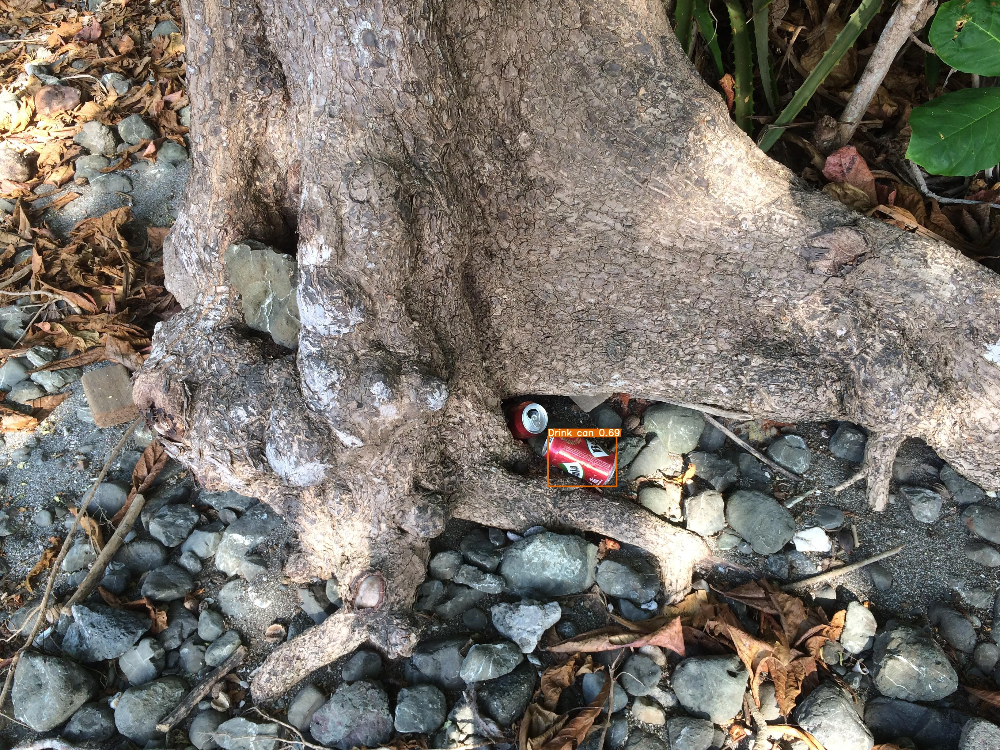

In [21]:
Image('inference/output/batch_7_000114.JPG')

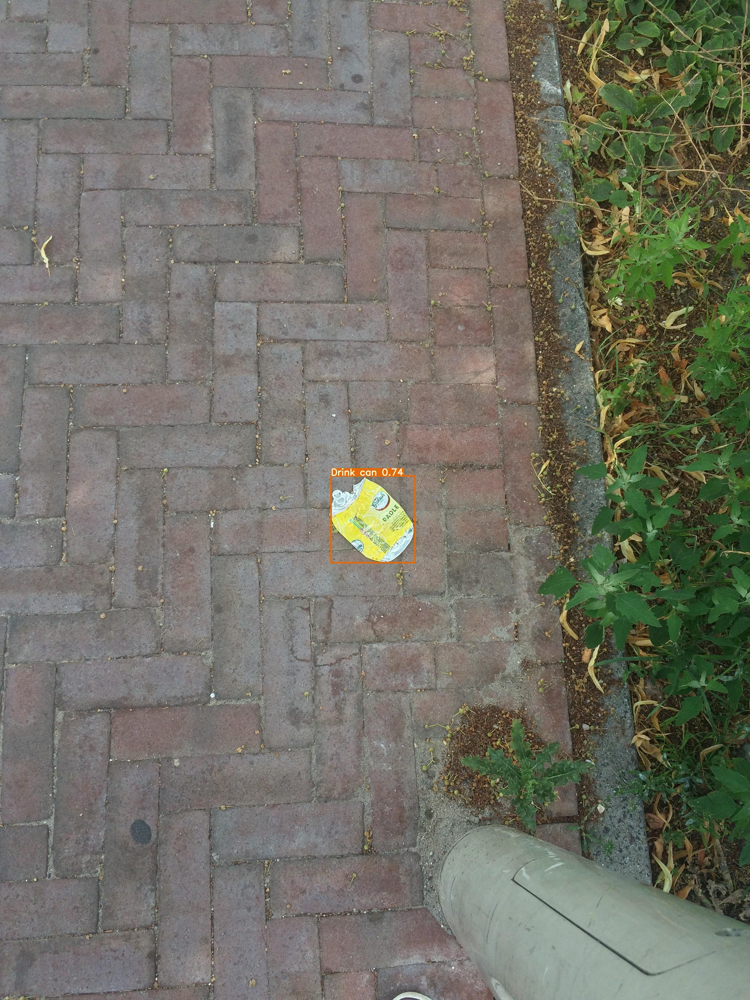

In [22]:
Image('inference/output/batch_8_000009.jpg')

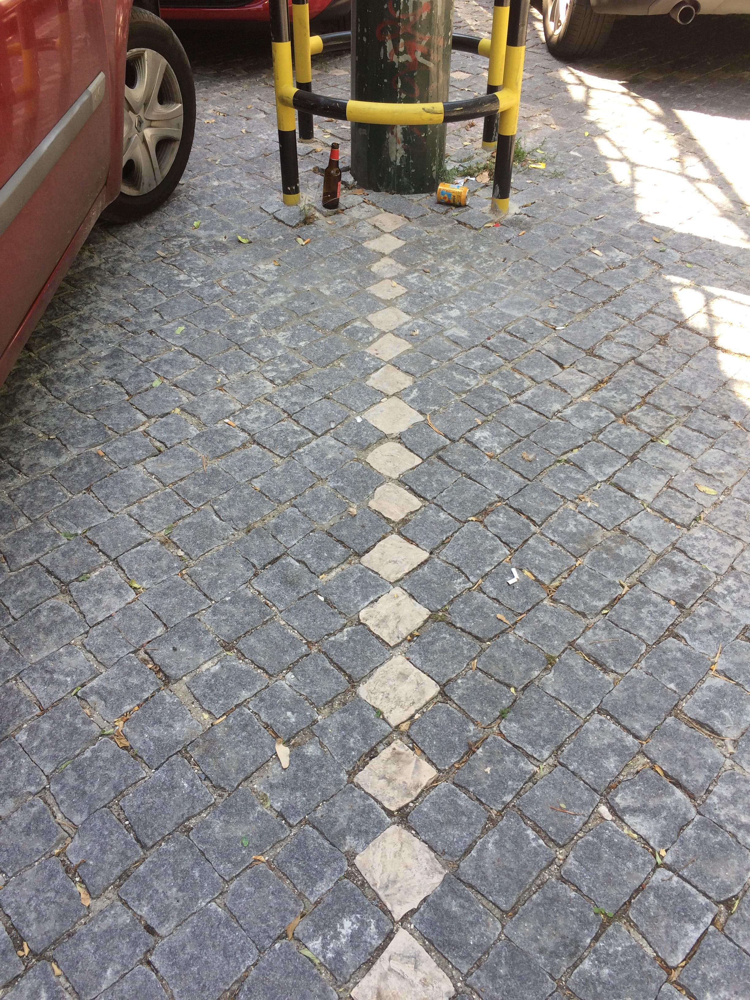

In [23]:
Image('inference/output/batch_8_000020.jpg')

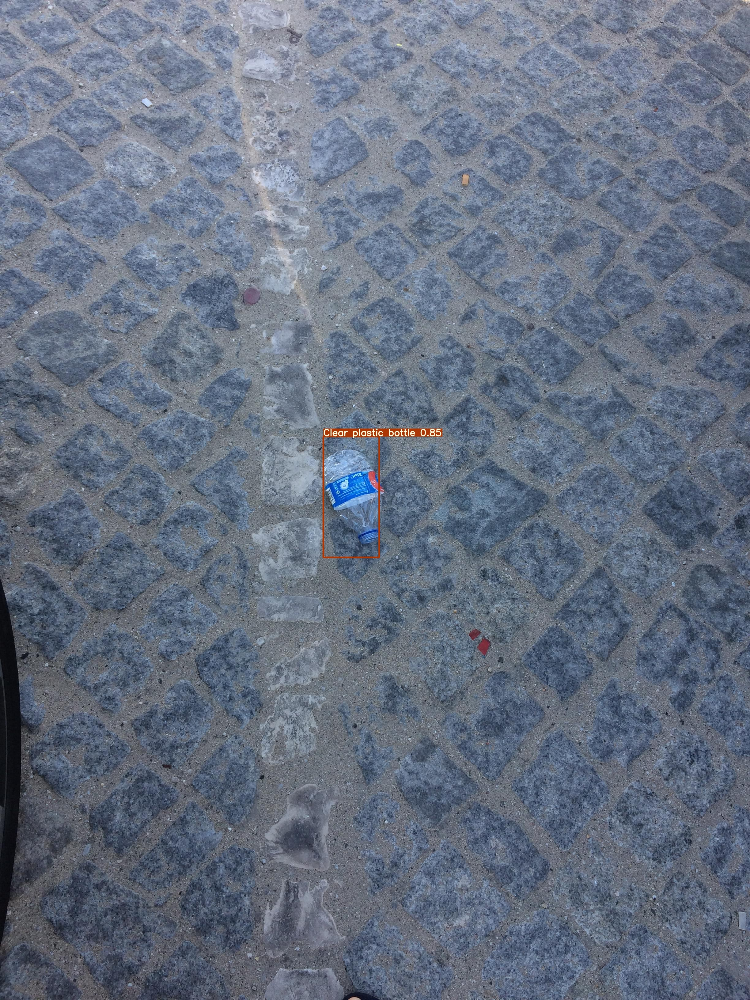

In [24]:
Image('inference/output/batch_8_000027.jpg')

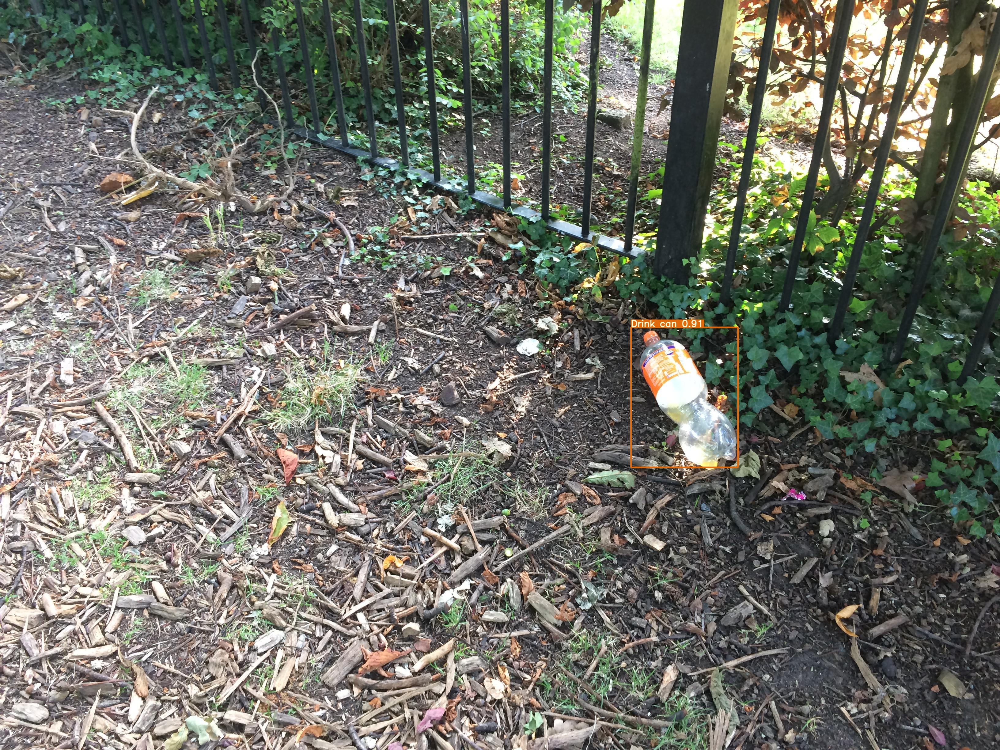

In [25]:
Image('inference/output/batch_8_000069.jpg')

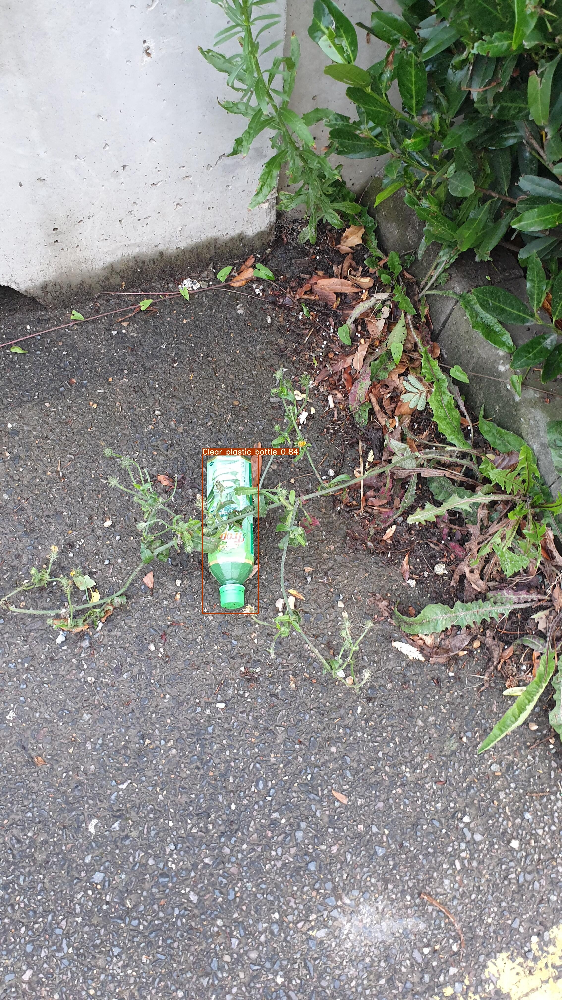

In [26]:
Image('inference/output/batch_8_000085.jpg')

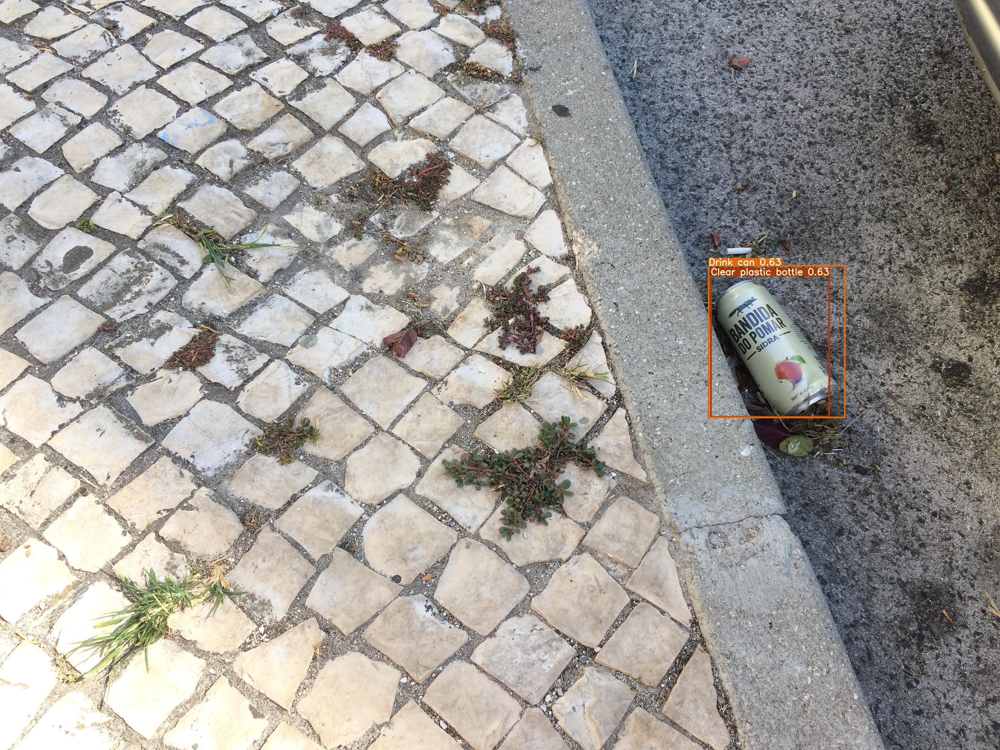

In [27]:
Image('inference/output/batch_9_000001.jpg')

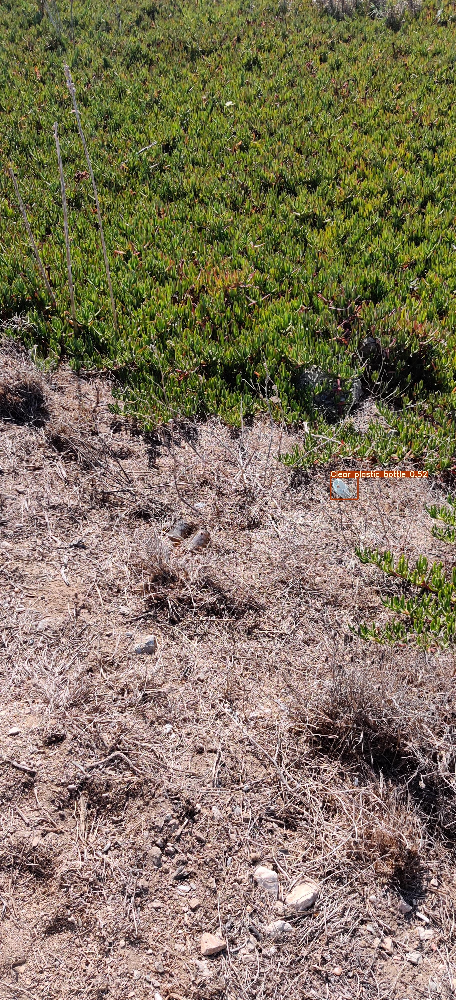

In [28]:
Image('inference/output/batch_9_000074.jpg')